# Applications of Mathematical Modelling
## Jocksan Villavicencio Villavicencio

**Problem 7.8.27:** Noise-induced oscillations

Stochastic systems can exhibit a range of oscillatory behaviors, ranging from near-perfect periodicity to erratic cycles. To explore this behavior, consider a stochastic relaxation oscillator studied by José Vilar and colleagues (Vilear _et al._, 2002). The system involves an activator and a repressor. The activator enhances expression of both proteins. The repressor acts by binding the activator, forming an inert complex. A simple model of the system is:

| Reaction name | Reaction | Propensity |
|---------------|----------|------------|
|$R_1:$ Activator synthesis | $\rightarrow b_A A$ | $\frac{\gamma_A}{b_A}\frac{\alpha_0 + N_A/K_A}{1 + N_A / K_A}$ |
|$R_2:$ Repressor synthesis | $\rightarrow b_R R$ | $\frac{\gamma_R}{b_R}\frac{N_A/K_R}{1 + N_A / K_R}$ |
|$R_3:$ Activator decay | $A \rightarrow$ | $\delta_A N_A$ |
|$R_4:$ Repressor decay | $R \rightarrow$ | $\delta_R N_R$ |
|$R_5:$ Association | $A + R \rightarrow C$ | $k_C N_A N_R$ |
|$R_6:$ Dissociation and decay | $C \rightarrow R$ | $\delta_A N_C$ |

Here $N_A, N_R,$ and $N_C$ are the molecular counts for the activator, repressor, and activator-repressor complex. The parameter $b_A$ and $b_R$ characterize the expression burst rate. The Hill-type propensities for the synthesis reactions are not well justified at the molecular level, but these expressions nevertheless provide a simple formulation of a stochastic relaxation oscillator.

In [2]:
using DifferentialEquations
using LaTeXStrings
using Random
using StatsBase
using Plots

## Exercise 1

**A) Take parameter values $\gamma_A = 250, b_A = 5, k_A = 0.5, \alpha_0 = 0.1, \delta_A = 1, \gamma_R = 50, b_R = 10, K_R = 1, k_C = 200,$ and $\delta_R = 0.1$. Run simulations of this model and verify its quasi-periodic behavior.**

<div class="alert alert-block alert-info">
    
> **Below I will show two implementations of the Gillespie algorithm, the *Direct method* and the *First Reaction method*, the former to show a single realization of the model, and the latter to show multiple realizations**

</div>

In [3]:
function ssa_direct(model, u0, tend, p, stoich; tstart=zero(tend))
    t = tstart   # Current time
    ts = [t]     # Time points
    u = copy(u0) # Current state
    us = copy(u) # Record of states
    while t < tend
        a = model(u, p, t)               # Propensities
        dt = randexp() / sum(a)          # Time step
        du = sample(stoich, Weights(a))  # Choose the stoichiometry for the next reaction
        u .+= du  # Update state
        t += dt   # Update time
        
        us = [us u]  # Append state variable to record
        push!(ts, t) # Append time point to record
    end
    # Make column as variables, rows as observations
    us = collect(us')
    return (t = ts, u = us)
end;

In [4]:
function ssa_first(model, u0, tend, p, stoich; tstart=zero(tend))
    t = tstart   # Current time
    ts = [t]     # Time points
    u = copy(u0) # Current state
    us = copy(u) # Record of states
    while t < tend
        a = model(u, p, t)  # propensities of reactions
        # dts from all reactions
        dts = randexp(length(a)) ./ a
        # Choose the reaction 
        i = argmin(dts)
        dt = dts[i]
        du = stoich[i]
        # Update state and time
        u .+= du
        t += dt
        us = [us u]  # Append state variable to record
        push!(ts, t) # Append time point to record
    end
    # Make column as variables, rows as observations
    us = collect(us')
    return (t = ts, u = us)
end;

In [5]:
# Propensity Reactions
model(u, p, t) = [(p.γₐ / p.bₐ) * (p.α₀ + u[1]/p.Kₐ)/(1 + u[1]/p.Kₐ),
                  (p.γᵣ / p.bᵣ) * (u[1]/p.Kᵣ)/(1 + u[1]/p.Kᵣ),
                  p.δₐ * u[1],
                  p.δᵣ * u[2],
                  p.kc * u[1] * u[2],
                  p.δₐ * u[3]]

# Parameters
p = (α₀ = 0.1, bₐ = 5, bᵣ = 10, γₐ = 250, γᵣ = 50, Kₐ = 0.5, Kᵣ = 1, δₐ = 1, δᵣ = 0.1, kc = 200) 

# stoichiometry/Reaction
stoich = [[p.bₐ * 1, 0, 0],
          [0, p.bᵣ * 1, 0],
          [-1, 0, 0],
          [0, -1, 0],
          [-1, -1, 1],
          [0, 1, -1]]

u₀ = [1, 1, 0]  # Initial conditions
tend = 100.0;   # Time to simulate

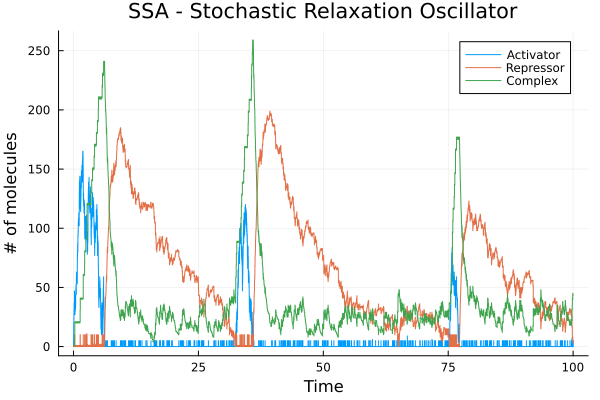

In [6]:
sol = ssa_direct(model, u₀, tend, p, stoich)
plot(sol.t, sol.u, xlabel = "Time", ylabel = "# of molecules", title = "SSA - Stochastic Relaxation Oscillator", label = ["Activator" "Repressor" "Complex"], linetype=:steppost)

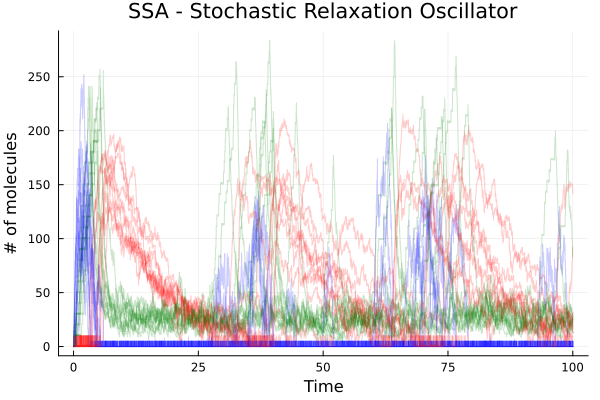

In [7]:
plot()
for i ∈ 1:10
    sol = ssa_first(model, u₀, tend, p, stoich)
    plot!(sol.t, sol.u, linecolor=[:blue :red :green], linealpha=0.2, label=false, linetype=:steppost)
end

plot!(xlabel = "Time", ylabel = "# of molecules", title = "SSA - Stochastic Relaxation Oscillator")

## Exercise 2

**B) The deterministic version of this model is:**

$$
\begin{aligned}
\frac{d}{dt} a(t) &= \gamma_A \frac{\alpha_0 + a(t) / K_A}{1 + a(t) / K_A} - k_C a(t) r(t) - \delta_A a(t) \\
\frac{d}{dt} r(t) &= \gamma_R \frac{a(t) / K_R}{1 + a(t) / K_R} - k_C a(t) r(t) + \delta_A c(t) - \delta_R r(t) \\
\frac{d}{dt} c(t) &= k_C a(t) r(t) - \delta_A c(t),
\end{aligned}
$$

**where $a, r,$ and $c$ are the concentration of activator, repressor, and complex. Run a simulation with the same parameter values as in part A). Does the system exhibit oscillations? How is the behavior different if you set $\delta_R = 0.2$?**

In [8]:
function det_model!(du, u, p, t)
    a, r, c = u
    α₀, γₐ, γᵣ, Kₐ, Kᵣ, δₐ, δᵣ, kc = p
    du[1] = da = γₐ * (α₀ + a/Kₐ)/(1 + a/Kₐ) - kc * a * r - δₐ * a
    du[2] = dr = γᵣ * (a/Kᵣ)/(1 + a/Kᵣ) - kc * a * r + δₐ * c - δᵣ * r
    du[3] = dc = kc * a * r - δₐ * c
end;

In [9]:
function anne!(du, u, p, t)
    Nn, Im, I = u
    A, B, C, δ, ϵ = p
    du[1] = dNn = A * (1 - Nn)/(ϵ + I) - B * (I * Nn)/(δ + Nn)
    du[2] = dIm = Nn^2 - Im
    du[3] = Im - C * ((1 - Nn)*I)/(ϵ + I)
end;

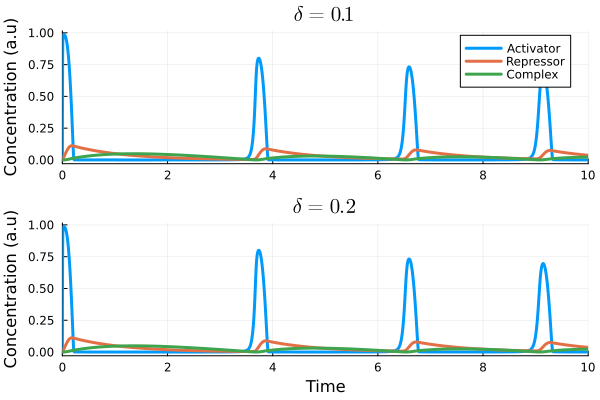

In [10]:
u₀ = [0.0, 0.0, 0.0]                     # a, r, c
tspan = (0.0, 10)
p = [0.007, 954.5, 0.035, 0.029, 2e-5]
prob = ODEProblem(anne!, u₀, tspan, p)
sol = solve(prob)
p1 = plot(sol, lw = 3, xaxis = "", ylabel = "Concentration (a.u)", label = ["Activator" "Repressor" "Complex"], title = L"$\delta = 0.1$")

p = [0.007, 954.5, 0.035, 0.029, 2e-5]  # α₀, γₐ, γᵣ, Kₐ, Kᵣ, δₐ, δᵣ, kc
prob = ODEProblem(anne!, u₀, tspan, p)
sol = solve(prob)
p2 = plot(sol, lw = 3, xlabel = "Time", ylabel = "Concentration (a.u)", label = false, title = L"$\delta = 0.2$")

plot(p1, p2, layout=(2,1))

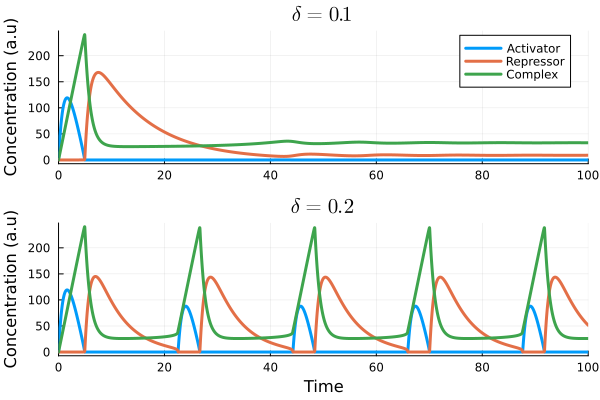

In [11]:
u₀ = [1.0, 1.0, 0.0]                     # a, r, c
tspan = (0.0, 100)
p = [0.1, 250, 50, 0.5, 1, 1, 0.1, 200]  # α₀, γₐ, γᵣ, Kₐ, Kᵣ, δₐ, δᵣ, kc
prob = ODEProblem(det_model!, u₀, tspan, p)
sol = solve(prob)
p1 = plot(sol, lw = 3, xaxis = "", ylabel = "Concentration (a.u)", label = ["Activator" "Repressor" "Complex"], title = L"$\delta = 0.1$")

p = [0.1, 250, 50, 0.5, 1, 1, 0.2, 200]  # α₀, γₐ, γᵣ, Kₐ, Kᵣ, δₐ, δᵣ, kc
prob = ODEProblem(det_model!, u₀, tspan, p)
sol = solve(prob)
p2 = plot(sol, lw = 3, xlabel = "Time", ylabel = "Concentration (a.u)", label = false, title = L"$\delta = 0.2$")

plot(p1, p2, layout=(2,1))

<div class="alert alert-block alert-success">

> **As we can tell, in the deterministic model when we consider the same parameters as in the SSA simulation, the oscillations dissapears, bringing the system to a stable steady state. However, setting $\delta_R = 0.2$ allows us to to observe the periodic behavior**

</div>

## Exercise 3

**C) The contrast between the behaviour of the models in part A) and B), for $\delta_R = 0.1$, can be explained by the excitabillity of this relaxation oscillator. Run two simulations of the deterministic model ($\delta_R = 0.1$), one from initial conditions $(a, r, c) = (0, 10, 35)$ and another from initial conditions $(a, r, c) = (5, 10, 35)$. Verify that in the first case, the activator is quenched by the repressor, and the system remains at a low-activator steady state, while in the second case, this small quantity of activator is able to break free from the repressor and invoke a (single) spike in expression. Explain how noise in the activator abundance could cause repeated excitations by allowing the activator abundance to regularly cross this threshold. This is referred to as _noise-induced oscillations_.**

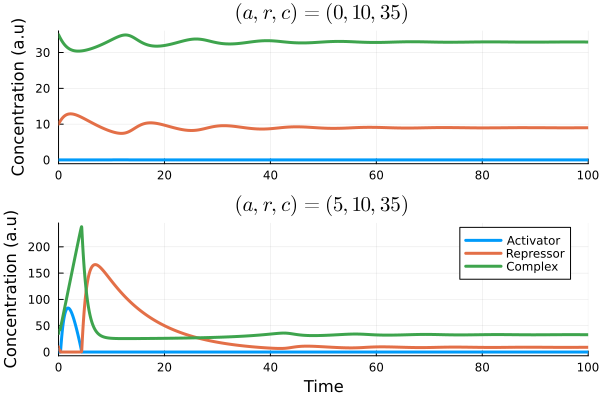

In [12]:
u₀ = [0.0, 10.0, 35.0]                   # a, r, c
p = [0.1, 250, 50, 0.5, 1, 1, 0.1, 200]  # α₀, γₐ, γᵣ, Kₐ, Kᵣ, δₐ, δᵣ, kc
prob = ODEProblem(det_model!, u₀, tspan, p)
sol = solve(prob)
p1 = plot(sol, lw = 3, xlabel = "", ylabel = "Concentration (a.u)", label = false, title = L"$(a,r,c) = (0,10,35)$")

u₀ = [5.0, 10.0, 35.0]                   # a, r, c
prob = ODEProblem(det_model!, u₀, tspan, p)
sol = solve(prob)
p2 = plot(sol, lw = 3, xlabel = "Time", ylabel = "Concentration (a.u)", label = ["Activator" "Repressor" "Complex"], title = L"$(a,r,c) = (5,10,35)$")

plot(p1, p2, layout=(2,1))
#plot!(legend=:outerbottom, legendcolumns=3)

<div class="alert alert-block alert-success">

> **As described in the question, it is possible that the system remains at a low-activator steady state, making it impossible for the system to experience a first spike of expression, and even if the first spike happens it does so only once because at some point the later repressor concentration is greater enough so that it quenches the activator, so there wont be any other spike burst. So, if we increase $\delta_R$ (repressor decay rate), then the system reaches a state where a periodic behaviour can be observed. The repressor decays faster that at some point in time it can't handle the expression of the activator so another expression burst happens.**

> **The presence of noise allows the system to exhibit quasi periodic behaviour, thanks to stochasticity the threshold of the activator can be surpassed either by a "random" increase of activator or by a "random" decrease of the repressor, allowing the activator to break free from the reppresor and show a burst of expression.** 

</div>